# DEPI Project

In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from category_encoders import BinaryEncoder
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OrdinalEncoder,OneHotEncoder
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

In [5]:
df=pd.read_csv("cardio_data_processed.csv", delimiter=",")

# check the distributions of the numerical features

In [6]:
# Distribution of the numerical features
# Only use columns present in processed data
for col in ['age_years','height','weight','ap_hi','ap_lo','bmi']:
    fig = px.histogram(df, x=col, width=600, marginal='box', nbins=20)
    fig.show()

In [7]:
df.quantile([0, 0.1, 0.25,  0.9, 0.95, 0.99, 1], numeric_only=True)

,id,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio,age_years,bmi
0.00,0.0,10798.0,1.0,55.0,11.0,90.0,60.0,1.0,1.0,0.0,0.0,0.0,0.0,29.0,3.471784
0.10,9986.4,15835.0,1.0,155.0,58.0,110.0,70.0,1.0,1.0,0.0,0.0,0.0,0.0,43.0,22.060354
0.25,24991.0,17656.0,1.0,159.0,65.0,120.0,80.0,1.0,1.0,0.0,0.0,1.0,0.0,48.0,23.875115
0.90,89966.8,22637.0,2.0,175.0,93.0,150.0,90.0,3.0,2.0,0.0,0.0,1.0,1.0,62.0,34.413196
0.95,94933.4,23256.0,2.0,178.0,100.0,160.0,100.0,3.0,3.0,1.0,1.0,1.0,1.0,63.0,37.253489
0.99,98978.8,23488.0,2.0,184.0,117.0,170.0,100.0,3.0,3.0,1.0,1.0,1.0,1.0,64.0,44.198484
1.00,99999.0,23713.0,2.0,250.0,200.0,180.0,120.0,3.0,3.0,1.0,1.0,1.0,1.0,64.0,298.666667


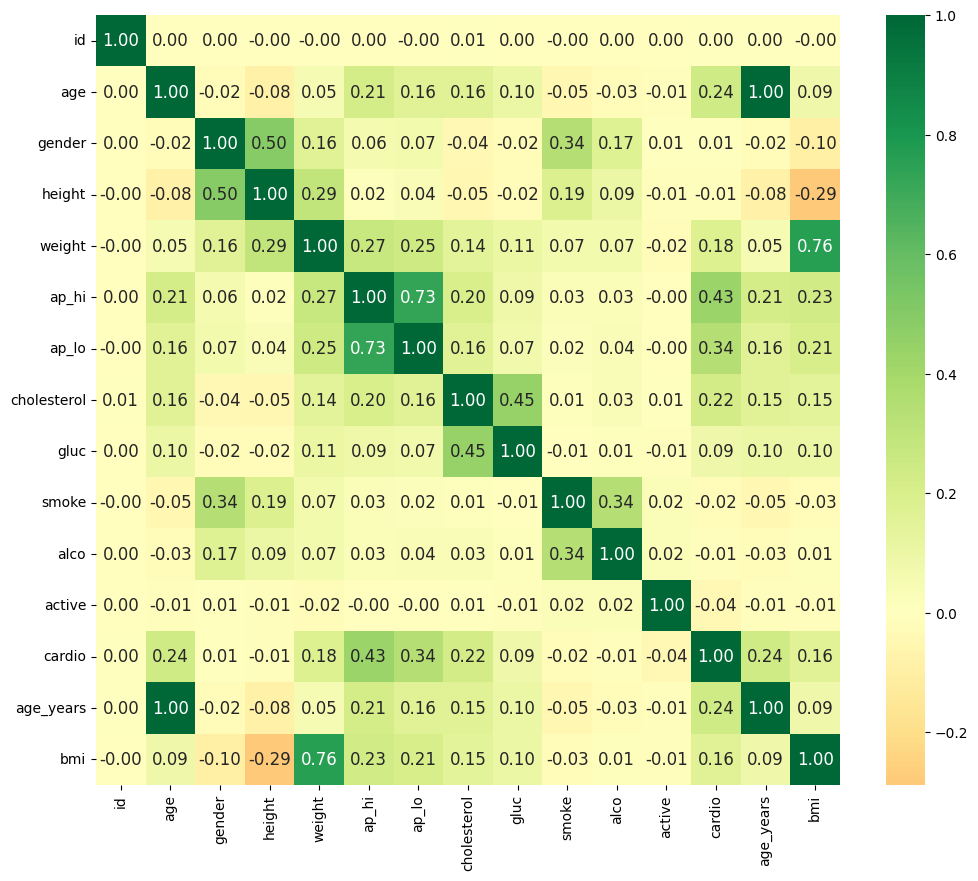

In [8]:
plt.figure(figsize=(12, 10)) 
sns.heatmap(df.corr(numeric_only=True), annot=True, cmap='RdYlGn', center=0, 
            annot_kws={'size': 12}, fmt='.2f')
plt.show()

In [9]:
# relation between api_hi and ap_lo
# relation between bmi and weight and inverse relation with height
# relation between glu and cholesterol 
# relation between age and cardio
# relation between cardio and age,bmi,chel,ap_hi.ap_lo, 

In [10]:
df.corr(numeric_only=True)['weight'].sort_values(ascending=False)

weight         1.000000
bmi            0.763079
height         0.292679
ap_hi          0.268289
ap_lo          0.250184
cardio         0.177829
gender         0.156027
cholesterol    0.139816
gluc           0.105734
alco           0.067177
smoke          0.067169
age            0.053321
age_years      0.053199
id            -0.002023
active        -0.017443
Name: weight, dtype: float64

In [11]:
asc_num_features = df.corr(numeric_only=True)['weight'].apply(abs).sort_values(ascending=False).drop('weight')
asc_num_features

bmi            0.763079
height         0.292679
ap_hi          0.268289
ap_lo          0.250184
cardio         0.177829
gender         0.156027
cholesterol    0.139816
gluc           0.105734
alco           0.067177
smoke          0.067169
age            0.053321
age_years      0.053199
active         0.017443
id             0.002023
Name: weight, dtype: float64

In [12]:
px.bar(asc_num_features, width=600, category_orders={'index':asc_num_features.index}, orientation='h')

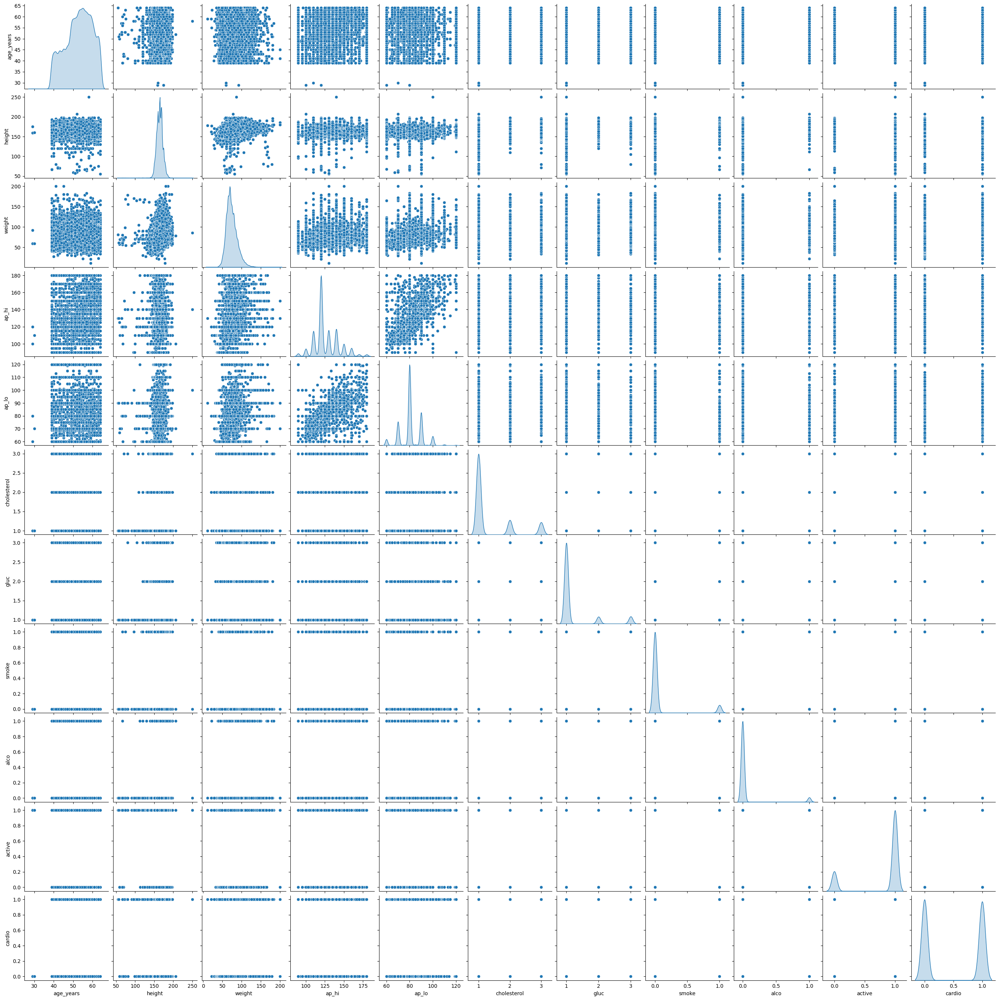

In [13]:
sns.pairplot(df[['age_years','height','weight','ap_hi','ap_lo','cholesterol','gluc','smoke','alco','active','cardio']], diag_kind='kde')

# Mapping Data

In [14]:
df['cholesterol'] = df['cholesterol'].astype(int)
df['smoke'] = df['smoke'].astype(int)
df['alco'] = df['alco'].astype(int)
df['active'] = df['active'].astype(int)
df['cardio'] = df['cardio'].astype(int)
df['gender'] = df['gender'].astype(int)
df['gluc']  = df['gluc'].astype(int)

In [15]:
df['alco'] = df['alco'].map({0: "Don't Consume", 1: 'Consume Alcohol'})
df['alco'] = df['alco'].astype('category')
df['cardio'] = df['cardio'].map({0: 'Absence', 1: 'Presence'})
df['cardio'] = df['cardio'].astype('category')
df['active'] = df['active'].map({0: 'Not physically active', 1: 'Physically active'})
df['active'] = df['active'].astype('category')
df['smoke'] = df['smoke'].map({0: 'Non-smoker', 1: 'Smoker'})
df['smoke'] = df['smoke'].astype('category')
df['gluc'] = df['gluc'].map({1: 'Normal', 2: 'Above Normal',3:'Well Above Normal'})
df['gluc'] = df['gluc'].astype('category')
df['cholesterol'] = df['cholesterol'].map({1: 'Normal', 2: 'Above Normal',3:'Well Above Normal'})
df['cholesterol'] = df['cholesterol'].astype('category')
df['gender'] = df['gender'].astype(int)
df['gender'] = df['gender'].map({1: 'Male', 2: 'Female'})
df['gender'] = df['gender'].astype('category')

# Categorical Univariate Analysis

In [16]:
def uni_cat_analysis(col):
    
  col_count = df[col].value_counts()
  bar = px.bar(data_frame=col_count,x=col_count.index,y=col_count.values,title=col)  
  plt.figure(figsize=(8, 5))
  plt.pie(col_count, labels=col_count.index, autopct='%.0f%%', startangle=90)
  plt.title("Pie Chart of "+col)
  plt.show()
  bar.show()

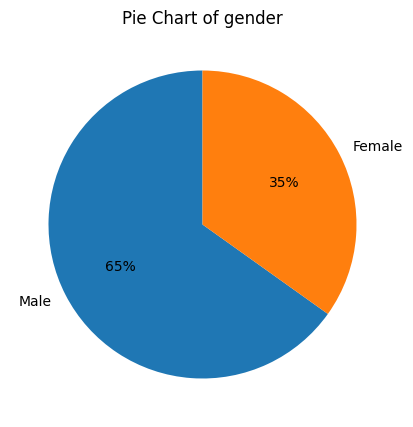

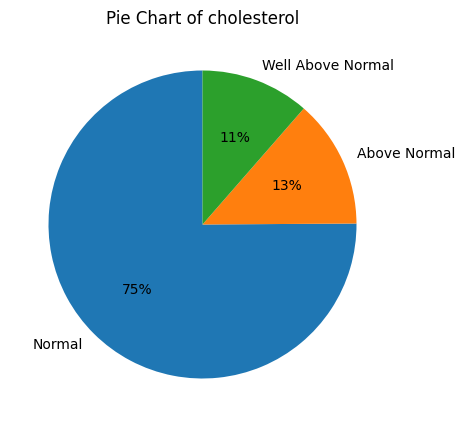

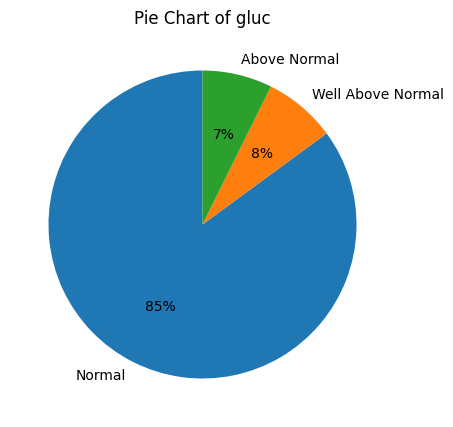

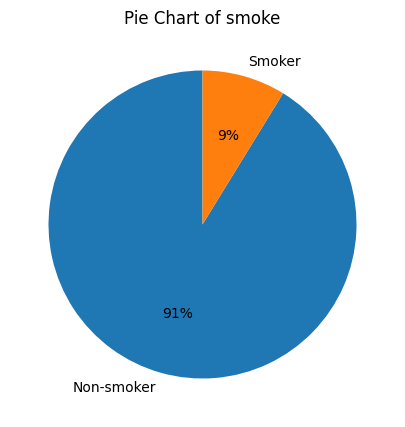

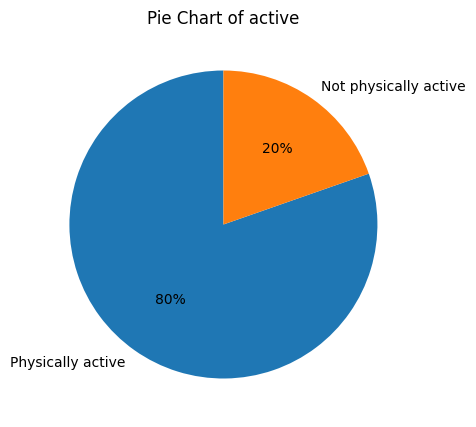

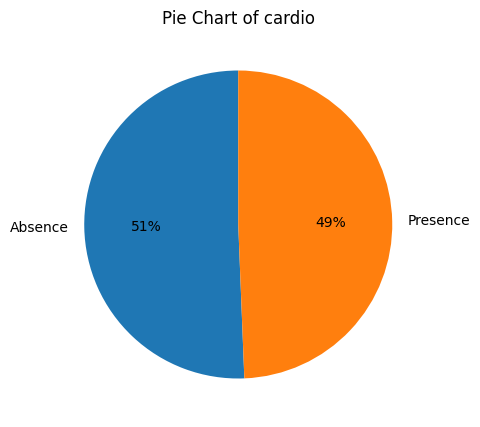

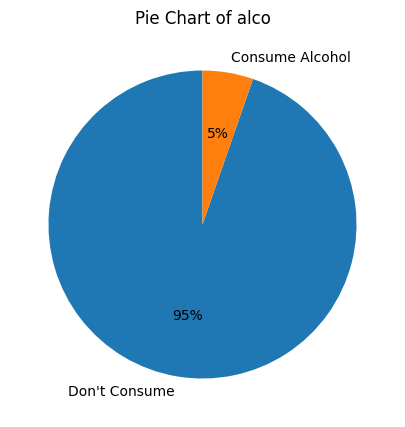

In [17]:
cat_columns = ['gender','cholesterol','gluc','smoke','active','cardio','alco']
for col in cat_columns:
    uni_cat_analysis(col)

# Bivariate Analysis

In [18]:
categorical_columns =  ['gender','cholesterol','gluc','smoke','active','alco']
for col in categorical_columns:
    fig = px.histogram(df, x=col, color='cardio', barmode='group',
                       title=f'{col} vs Cardiovascular Disease',template="presentation", color_discrete_sequence=["#6699ff","#fe6949"])
    fig.update_xaxes(title_font_size=18)
    fig.update_yaxes(title_text="Count", title_font_size=18)
    fig.show()

In [19]:
#Age vs Cardio
fig = px.histogram(df, x="cardio",y="age_years",title='Age vs Cardio',template="presentation",histfunc = 'avg', color="cardio", color_discrete_map={'Absence': '#6699ff', 'Presence': '#fe6949'}  )
fig.update_yaxes(title_text="Avg of age")
fig.show()

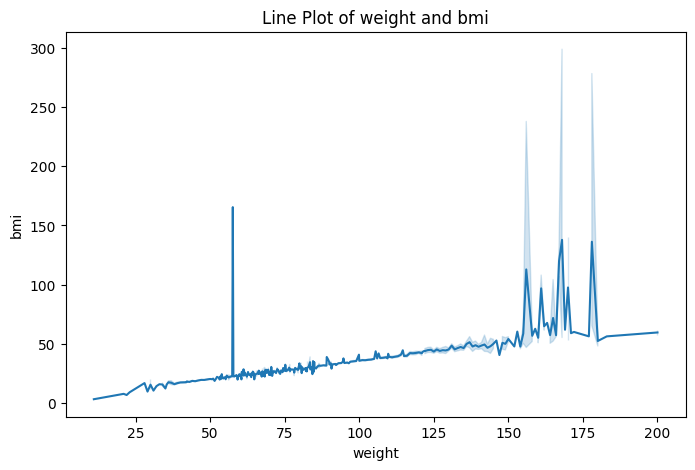

In [20]:
# Line Plot Example
plt.figure(figsize=(8, 5))
sns.lineplot(x="weight", y="bmi", data=df, estimator="mean") 
plt.title("Line Plot of weight and bmi")
plt.show()

# Multivariate Analysis

In [21]:
# relation between bmi and weight and inverse relation with height
# relation between glu and cholesterol 
# relation between age and cardio
# relation between cardio and age,bmi,chel,ap_hi.ap_lo, 

In [22]:
px.scatter(df, x='ap_hi', y='ap_lo', width=1000, height=700, color = 'cardio')

In [23]:
px.scatter(df, x='weight', y='height', width=1000, height=700)

In [24]:
px.scatter(df, x='ap_hi', y='ap_lo', width=1000, height=700)

In [25]:
grouped_df = df.groupby(['cholesterol', 'cardio'])['age_years'].mean().reset_index()

fig = px.bar(
    grouped_df,
    x='cholesterol',
    y='age_years',
    color='cardio',
    barmode='group',
    labels={'age': 'Average Age', 'cholesterol': 'Cholesterol Level', 'cardio': 'Cardio Outcome'},
    title='Average Age by Cholesterol Level and Cardio Outcome'
)
fig.show()

/tmp/ipykernel_596/2335533500.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

